<a href="https://colab.research.google.com/github/KwanHoo/COCO_dataset_YOLOv5_test/blob/main/vehiclesdataset_yoloV5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YOLOv5 모델 vehicles 데이터셋을 활용하여 객체탐지 테스트

- Yolo v5 모델을 탈것데이터셋으로 학습시키기
- EnlightenGAN으로 조도개선 시킨 이미지 객체 탐지 테스트
- gary scale로 변환한 이미지 객체 탐지 테스트
- 검정 차량 이미지 객체 탐지 테스트

Vehicles 데이터 셋 다운

In [2]:
!curl -L "https://public.roboflow.com/ds/2L8qetyd0Q?key=39hpjBfBEr" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   888  100   888    0     0   1523      0 --:--:-- --:--:-- --:--:--  1523
100 38.4M  100 38.4M    0     0  37.7M      0  0:00:01  0:00:01 --:--:--  139M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/00dea1edf14f09ab_jpg.rf.3f17c8790a68659d03b1939a59ccda80.jpg  
 extracting: test/images/00dea1edf14f09ab_jpg.rf.KJ730oDTFPdXdJxvSLnX.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.6e6a8b3b45c9a11d106958f88ff714ea.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.MV6sZ8QCFwFeMYaI2tHm.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.7IkYAamjZhnwsoXSrwKt.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.effa65856584463c08848031cab357b9.jpg  
 extractin

# YOLO v5 모델 깃허브로 클론 다운

In [3]:
%cd /content
!git clone https://github.com/ultralytics/yolov5.git

/content
Cloning into 'yolov5'...
remote: Enumerating objects: 8950, done.
remote: Counting objects: 100% (195/195), done.
remote: Compressing objects: 100% (132/132), done.
remote: Total 8950 (delta 98), reused 105 (delta 63), pack-reused 8755
Receiving objects: 100% (8950/8950), 9.52 MiB | 26.79 MiB/s, done.
Resolving deltas: 100% (6185/6185), done.


# YOLO v5를 위한 패키지 설치

In [4]:
%cd /content/yolov5/
!pip install -r requirements.txt

/content/yolov5
     |████████████████████████████████| 636 kB 5.2 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


# 데이터셋 폴더에 data.yami
- train
- validation
- nc: 클래스 갯수
- 클래스 이름

In [5]:
%cat /content/dataset/data.yaml

train: ../train/images
val: ../valid/images

nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

- train image 갯수 : 878
- valid image 갯수 : 250

In [6]:
%cd /
from glob import glob

t_img_list = glob('/content/dataset/train/images/*.jpg')

print(len(t_img_list))

/
878


In [7]:
v_img_list = glob('/content/dataset/valid/images/*.jpg')

print(len(v_img_list))

250


# 트레이닝 이미지 경로, 벨리데이션 이미지 경로 txt 파일로 저장

In [8]:
with open('/content/dataset/train.txt', 'w') as f:
  f.write('\n'.join(t_img_list) + '\n')

with open('/content/dataset/val.txt', 'w') as f:
  f.write('\n'.join(v_img_list) + '\n')

# data.yaml 수정 (train, valid)

In [9]:
import yaml

with open('/content/dataset/data.yaml', 'r') as f:
  data = yaml.load(f)

print(data)

data['train'] = '/content/dataset/train.txt'
data['val'] = '/content/dataset/val.txt'

with open('/content/dataset/data.yaml', 'w') as f:
  yaml.dump(data, f)

print(data)

{'train': '../train/images', 'val': '../valid/images', 'nc': 5, 'names': ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']}
{'train': '/content/dataset/train.txt', 'val': '/content/dataset/val.txt', 'nc': 5, 'names': ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']}


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  after removing the cwd from sys.path.


# YOLO 학습(이미지 사이즈: 640, batch: 16, epochs: 40)
# YOLO 학습 cfg(모델) : modles폴더에 있음

In [10]:
%cd /content/yolov5/

!python train.py --img 640 --batch 16 --epochs 40 --data /content/dataset/data.yaml --cfg ./models/yolov5s.yaml --weights yolov5s.pt --name gun_yolov5s_results

/content/yolov5
train: weights=yolov5s.pt, cfg=./models/yolov5s.yaml, data=/content/dataset/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=gun_yolov5s_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7,

# Tensorboard로 학습 결과 확인

In [11]:
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs/

<IPython.core.display.Javascript object>

# 예측 결과 확인

detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/dataset/valid/images/37f9a68f16667494_jpg.rf.d62bc285ad93f27c813fa6cda6065946.jpg, imgsz=640, conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 224 layers, 7064698 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/dataset/valid/images/37f9a68f16667494_jpg.rf.d62bc285ad93f27c813fa6cda6065946.jpg: 640x640 1 Ambulance, Done. (0.014s)
Results saved to runs/detect/exp
Done. (0.025s)


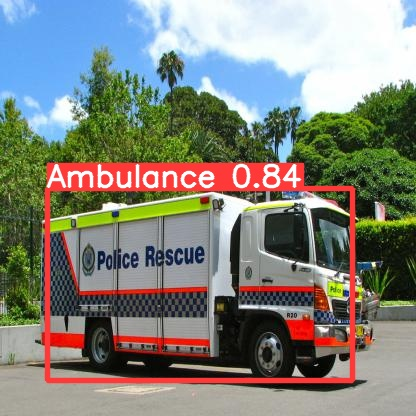

In [27]:
from IPython.display import Image
import os

val_img_path = v_img_list[3]

!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 640 --conf 0.4 --source "{val_img_path}"

Image(os.path.join('/content/yolov5/runs/detect/exp', os.path.basename(val_img_path)))

# EnlightenGAN으로 조도 개선 시킨 이미지 객체 탐지 테스트


In [24]:
t_img_list2 = glob('/content/test_img/*.png')

print(len(t_img_list2))

2


detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/test_img/dst12_screenshot_11.08.2021.png, imgsz=640, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 224 layers, 7064698 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/test_img/dst12_screenshot_11.08.2021.png: 480x640 1 Car, Done. (0.012s)
Results saved to runs/detect/exp
Done. (0.114s)


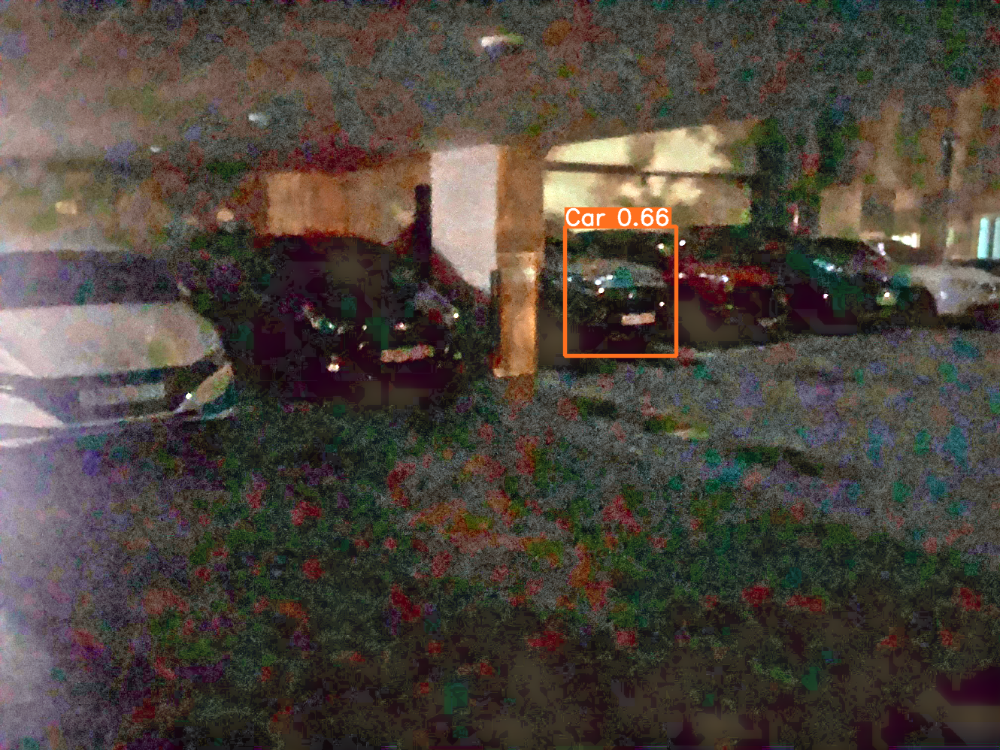

In [28]:
test_img_path = t_img_list2[1]


!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 640 --conf 0.5 --source "{test_img_path}"

Image(os.path.join('/content/yolov5/runs/detect/exp', os.path.basename(test_img_path)))

In [29]:
g_img_list3 = glob('/content/gray_img/*.jpg')

print(len(g_img_list3))

4


detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/gray_img/KakaoTalk_20210720_213727400.jpg, imgsz=640, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 224 layers, 7064698 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/gray_img/KakaoTalk_20210720_213727400.jpg: 480x640 4 Cars, Done. (0.013s)
Results saved to runs/detect/exp
Done. (0.460s)


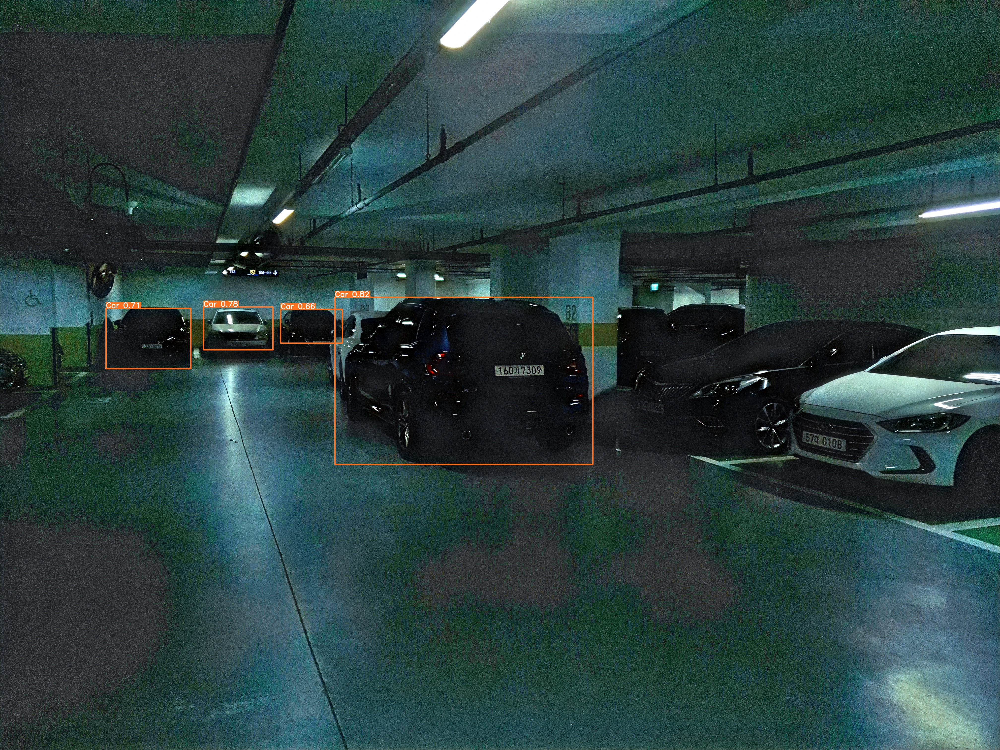

In [32]:
gray_img_path = g_img_list3[0]


!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 640 --conf 0.5 --source "{gray_img_path}"

Image(os.path.join('/content/yolov5/runs/detect/exp', os.path.basename(gray_img_path)))

detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/gray_img/KakaoTalk_20210811_144832280.jpg, imgsz=640, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 224 layers, 7064698 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/gray_img/KakaoTalk_20210811_144832280.jpg: 480x640 1 Car, Done. (0.013s)
Results saved to runs/detect/exp
Done. (0.347s)


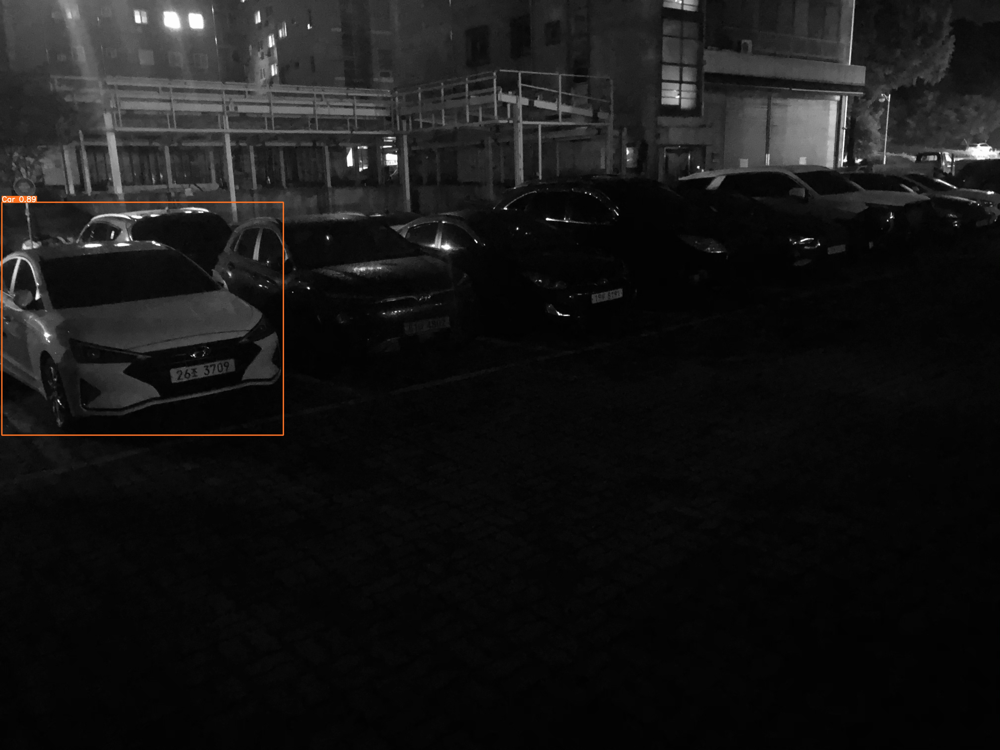

In [35]:
gray_img_path = g_img_list3[2]


!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 640 --conf 0.5 --source "{gray_img_path}"

Image(os.path.join('/content/yolov5/runs/detect/exp', os.path.basename(gray_img_path)))

detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/gray_img/KakaoTalk_20210811_144832280_01.jpg, imgsz=640, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 224 layers, 7064698 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/gray_img/KakaoTalk_20210811_144832280_01.jpg: 480x640 3 Cars, Done. (0.013s)
Results saved to runs/detect/exp
Done. (0.361s)


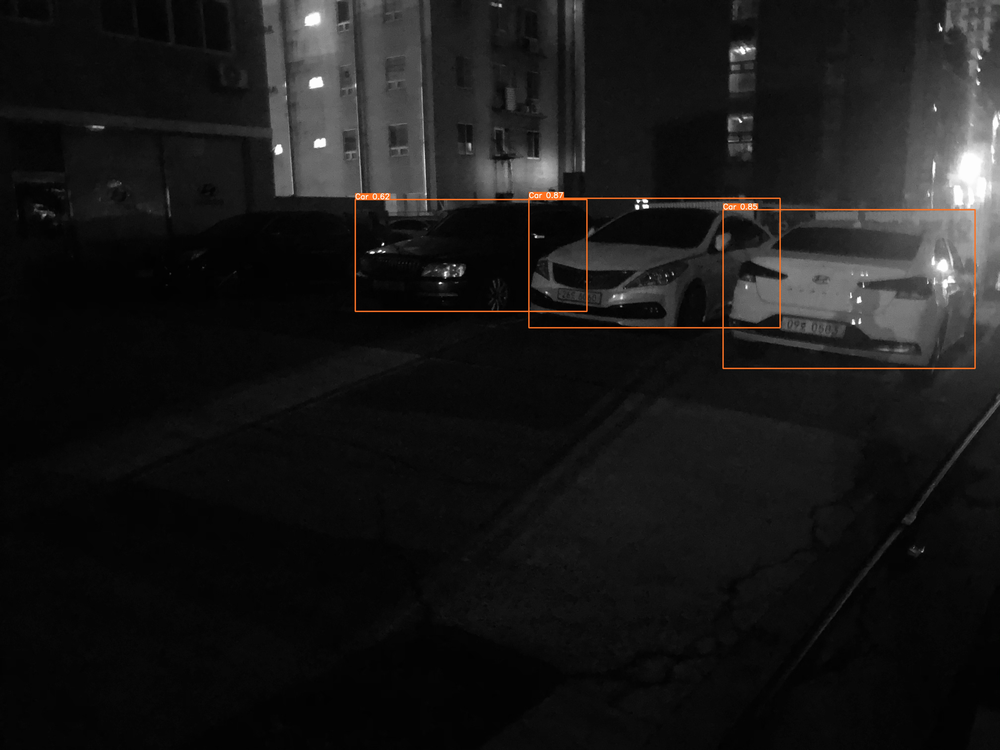

In [36]:
gray_img_path = g_img_list3[3]


!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 640 --conf 0.5 --source "{gray_img_path}"

Image(os.path.join('/content/yolov5/runs/detect/exp', os.path.basename(gray_img_path)))

# 검정 자동차 이미지 yolo로 객체 탐지

In [41]:
c_img_list4 = glob('/content/car_img/*.JPG')

print(len(c_img_list4))

2


detect: weights=['/content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt'], source=/content/car_img/GM대우_알페온_2011_18시대_H225_V0.JPG, imgsz=640, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-367-g01cdb76 torch 1.9.0+cu102 CUDA:0 (Tesla P4, 7611.9375MB)

Fusing layers... 
Model Summary: 224 layers, 7064698 parameters, 0 gradients, 16.4 GFLOPs
image 1/1 /content/car_img/GM대우_알페온_2011_18시대_H225_V0.JPG: 480x640 1 Car, Done. (0.013s)
Results saved to runs/detect/exp
Done. (0.124s)


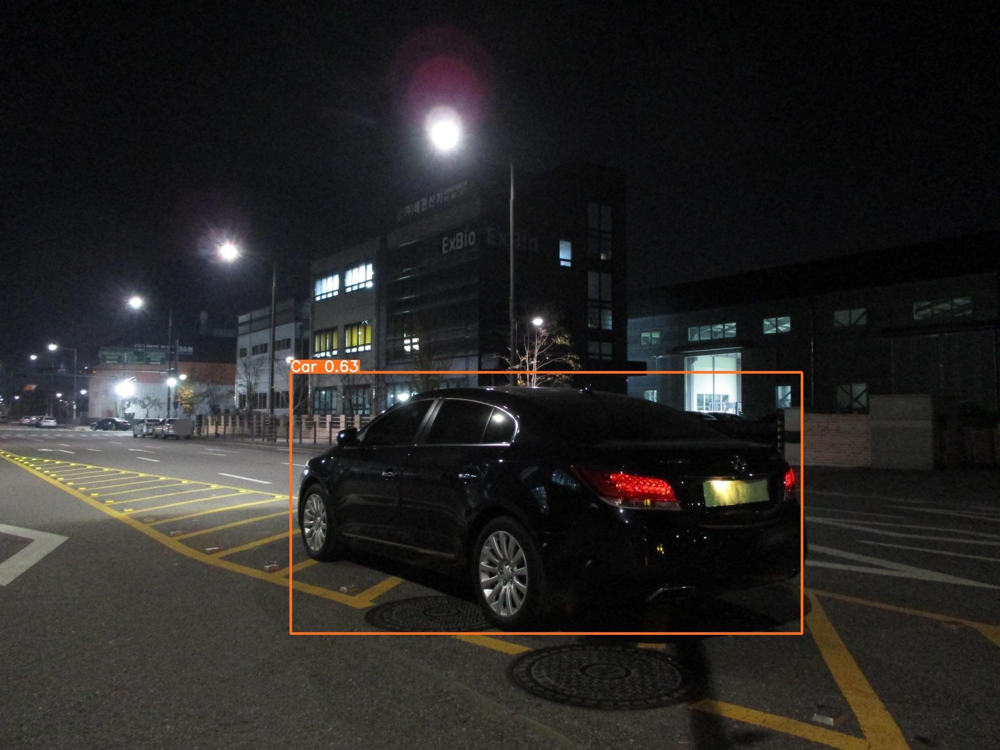

In [43]:
car_img_path = c_img_list4[0]


!python detect.py --weights /content/yolov5/runs/train/gun_yolov5s_results/weights/best.pt --img 640 --conf 0.5 --source "{car_img_path}"

Image(os.path.join('/content/yolov5/runs/detect/exp', os.path.basename(car_img_path)))